In [1]:
!pip install ydata-profiling
!pip install lazypredict
!pip install xgboost
!pip install lightgbm
!pip install scikit-learn
!pip install evidently
!pip install shap
!pip install lime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.3/399.3 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 21.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.7/679.7 kB 19.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.3/37.3 MB 10.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 1.2 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.16.2
    Uninstalling scipy-1.16.2:
      Successfully uninstalled scipy-1.16.2
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 19.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.7/26.7 MB 23.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 24

In [2]:
import pandas as pd
import numpy as np
import random
import joblib
import os
from scipy.stats import norm
import matplotlib.pyplot as plt
import seaborn as sns
import re

from ydata_profiling import ProfileReport

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, recall_score, accuracy_score, roc_auc_score, confusion_matrix, classification_report
from sklearn.metrics import (
    r2_score, mean_absolute_error, mean_squared_error, median_absolute_error
)

from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestRegressor

from evidently import Report
from evidently import Dataset, DataDefinition
from evidently.descriptors import Sentiment, TextLength, Contains
from evidently.presets import TextEvals
from evidently.presets import DataDriftPreset
from evidently.presets import ClassificationPreset

import xgboost as xgb
from xgboost import XGBRegressor
import lightgbm as lgb
import matplotlib.pyplot as plt
import seaborn as sns
import shap

import lime.lime_text
import lime
import lime.lime_tabular



In [3]:
df = pd.read_csv("transaction_data.csv")
df.head()

,Unnamed: 0,year,subject,brand,variety,card_number,date,price,grade,grading_company
0,0,2018,Deandre Ayton,Panini Donruss Optic,NaN,157,2021-06-22,35.00,9.00,PSA
1,1,2018,Luka Doncic,Panini Prizm,Silver Prizm,280,2019-05-31,465.00,10.00,PSA
2,2,2018,Shai Gilgeous-Alexander,Panini Donruss Optic,Shock,162,2021-10-20,49.00,9.00,PSA
3,3,2018,Tim Hardaway,Panini Prizm fast break autographs,gold prizm,28,2019-08-28,45.00,9.50,BGS
4,4,2018,LeBron James,PANINI PRIZM GET HYPED!,NaN,4,2020-06-26,42.99,10.00,PSA


In [36]:

def exploratory_data_analysis(csv_path="transaction_data.csv"):
  # Load the dataset
  df = pd.read_csv(csv_path)

  # Generate the profile report
  profile = ProfileReport(df, title="Data Profile Report")

  # Save the report to an HTML file
  profile.to_file(csv_path.replace(".csv", ".html"))

  print("Profile report generated and saved as transaction_data.html")

  return profile

profile_report = exploratory_data_analysis(csv_path="transaction_data.csv")
profile_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 10/10 [00:03<00:00,  2.58it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report generated and saved as transaction_data.html


 We see that the exploratory data shows:

* year is constant, so just data from 2018 - might not reflect data outside of 2018
* grading_company is highly imbalanced (63.4%)	- should look at price within each grading company
* variety has 44796 (44.8%) missing values	- need to address missingness or separate models for different varieties
* price is highly skewed (γ1 = 260.7736196) - probably need to transform because right tail skew can't be handled linearly very easily


# Generate features for MVP non-ML scoring algorithm


In [18]:

def generate_features(df: pd.DataFrame) -> pd.DataFrame:
    """
    Comprehensive feature generator for sports card price estimation.

    Combines:
      - Static card attributes (year, brand, grade, etc.)
      - Derived time features (date, month, seasonality)
      - Text-based encodings and flags (gold, prizm, auto)
      - Price-based analytics: outliers, decile tiers
      - Card-level aggregates and historical price trend detection

    Returns:
        pd.DataFrame: Original DataFrame + all engineered features
    """

    df = df.copy()

    # --- Normalize text columns ---
    text_cols = ['subject', 'brand', 'variety', 'card_number', 'grading_company']
    for col in text_cols:
        if col in df.columns:
            df[col] = df[col].astype(str).str.lower().str.strip()

    # --- Handle missing 'variety' gracefully ---
    if 'variety' not in df.columns:
        df['variety'] = ""

    # --- Convert and extract date features ---
    df['date'] = pd.to_datetime(df['date'], errors='coerce')
    df['year_sold'] = df['date'].dt.year
    df['month_sold'] = df['date'].dt.month
    df['day_sold'] = df['date'].dt.day
    df['days_since_release'] = (
        df['date'] - pd.to_datetime(df['year'].astype(str) + '-01-01', errors='coerce')
    ).dt.days
    df['is_holiday_season'] = df['month_sold'].isin([11, 12]).astype(int)

    # --- Encode categorical variables ---
    label_cols = ['brand', 'variety', 'grading_company']
    for col in label_cols:
        le = LabelEncoder()
        df[f'{col}_encoded'] = le.fit_transform(df[col].astype(str))

    # --- Card number features ---
    df['card_number_len'] = df['card_number'].str.len()
    df['card_number_numeric'] = (
        df['card_number'].str.extract(r'(\d+)').fillna(0).astype(int)
    )

    # --- Subject features ---
    df['num_subjects'] = df['subject'].str.count(',') + 1

    # --- Variety features (even if mostly empty) ---
    df['is_gold'] = df['variety'].str.contains('gold', regex=True).astype(int)
    df['is_silver'] = df['variety'].str.contains('silver', regex=True).astype(int)
    df['is_prizm'] = df['variety'].str.contains('prizm', regex=True).astype(int)
    df['is_auto'] = df['variety'].str.contains('auto|autograph', regex=True).astype(int)

    # --- Grading features ---
    df['is_psa'] = df['grading_company'].str.contains('psa', regex=True).astype(int)
    df['is_bgs'] = df['grading_company'].str.contains('bgs', regex=True).astype(int)
    df['grade'] = pd.to_numeric(df['grade'], errors='coerce')
    df['grade_is_high'] = (df['grade'] >= 9).astype(int)

    # --- Interaction features ---
    df['grade_x_brand'] = df['grade'] * df['brand_encoded']
    df['grade_x_year'] = df['grade'] * df['year']

    # --- Log-transformed price for modeling baseline ---
    df['log_price'] = np.log1p(df['price'])

    # ---------------------------------------------------------------------
    # 🔍 PRICE-BASED FEATURES AND HISTORICAL CARD TRENDS
    # ---------------------------------------------------------------------

    # --- Unique card identifier ---
    df['card_id'] = (
        df['subject'].astype(str) + '_' +
        df['brand'].astype(str) + '_' +
        df['variety'].astype(str) + '_' +
        df['card_number'].astype(str)
    )

    # --- Outlier detection using IQR ---
    q1, q3 = df['price'].quantile([0.25, 0.75])
    iqr = q3 - q1
    upper = q3 + 1.5 * iqr
    lower = q1 - 1.5 * iqr
    df['is_outlier'] = ((df['price'] > upper) | (df['price'] < lower)).astype(int)

    # --- Price tiers (10 percentile bins) ---
    df['price_tier'] = pd.qcut(df['price'], 10, labels=False, duplicates='drop')

    # --- Card-level aggregates ---
    card_stats = df.groupby('card_id').agg(
        sale_count_per_card=('price', 'count'),
        avg_price_per_card=('price', 'mean'),
        std_price_per_card=('price', 'std'),
        first_sale=('date', 'min'),
        last_sale=('date', 'max')
    ).reset_index()

    # --- Compute price trend over time per card ---
    def compute_trend(grp):
        if grp['date'].nunique() < 2:
            return np.nan
        x = grp['date'].map(pd.Timestamp.toordinal)
        y = grp['log_price']
        return np.corrcoef(x, y)[0, 1]

    trend_df = df.groupby('card_id').apply(compute_trend).reset_index(name='trend_score')

    # --- Merge back card-level features ---
    df = df.merge(card_stats, on='card_id', how='left')
    df = df.merge(trend_df, on='card_id', how='left')

    # --- Fill in missing values for cards with one sale ---
    df['trend_score'] = df['trend_score'].fillna(0)
    df['std_price_per_card'] = df['std_price_per_card'].fillna(0)

    # --- Derived trend flags ---
    df['days_between_sales'] = (df['last_sale'] - df['first_sale']).dt.days.fillna(0)
    df['is_trending_up'] = (df['trend_score'] > 0).astype(int)
    df['is_trending_down'] = (df['trend_score'] < 0).astype(int)

    # ---------------------------------------------------------------------
    # ✅ RETURN: ORIGINAL + ENGINEERED FEATURES
    # ---------------------------------------------------------------------
    df = df.fillna(0)
    return df


In [19]:
features = generate_features(df)
print(features.head())

   Unnamed: 0  year                  subject  \
0           0  2018            deandre ayton   
1           1  2018              luka doncic   
2           2  2018  shai gilgeous-alexander   
3           3  2018             tim hardaway   
4           4  2018             lebron james   

                                brand       variety card_number       date  \
0                panini donruss optic           nan         157 2021-06-22   
1                        panini prizm  silver prizm         280 2019-05-31   
2                panini donruss optic         shock         162 2021-10-20   
3  panini prizm fast break autographs    gold prizm          28 2019-08-28   
4             panini prizm get hyped!           nan           4 2020-06-26   

   price  grade grading_company  ... price_tier  sale_count_per_card  \
0  35.00   9.00             psa  ...          2                  212   
1 465.00  10.00             psa  ...          8                  919   
2  49.00   9.00           

Lets inspect some of the raw data based on these new features to look at cards with multiple transactions.

In [21]:
# Select only cards that have fewer than 3 recorded sales
low_sale_cards = features[features['sale_count_per_card'] > 3]

print(low_sale_cards.shape)
print(low_sale_cards[['card_id', 'subject', 'brand', 'card_number', 'sale_count_per_card']].head())

(11421, 43)
                                              card_id         subject  \
3   tim hardaway_panini prizm fast break autograph...    tim hardaway   
8              luka doncic_panini chronicles_gold_645     luka doncic   
17          troy brown jr._national treasures_nan_113  troy brown jr.   
35  dzanan musa_panini contenders optic_white jers...     dzanan musa   
47    mo bamba_panini revolution_chinese new year_101        mo bamba   

                                 brand card_number  sale_count_per_card  
3   panini prizm fast break autographs          28                    2  
8                    panini chronicles         645                    1  
17                  national treasures         113                    2  
35             panini contenders optic         103                    2  
47                   panini revolution         101                    2  


# explore newly generated features

In [37]:
features.to_csv("features.csv")
profile_report = exploratory_data_analysis(csv_path="features.csv")
profile_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 44/44 [00:07<00:00,  5.91it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Profile report generated and saved as transaction_data.html


# Instructions
Build an mvp price estimator without using machine learning in order to establish a baseline and get a feel for the project.


For example you could use the most recent previous transaction to predict the next transaction.

In [41]:


def baseline_price_estimator(features: pd.DataFrame):
    """
    Baseline non-ML price estimator:
      - For each card_id, sort by date
      - Predict each sale's price using the most recent previous sale
      - Compute basic evaluation metrics (MAE, MAPE)
    """

    df = features.copy()
    df = df.sort_values(['card_id', 'date'])

    # --- For each card, get previous transaction's price ---
    df['prev_price'] = df.groupby('card_id')['price'].shift(1)

    # --- Naive prediction = previous sale price ---
    df['predicted_price'] = df['prev_price']

    # --- Handle first sale per card (no history) ---
    # Option 1: fill with average of same brand or overall mean
    brand_avg = df.groupby('brand')['price'].transform('mean')
    df['predicted_price'] = df['predicted_price'].fillna(brand_avg)
    df['predicted_price'] = df['predicted_price'].fillna(df['price'].mean())

    # --- Compute residuals ---
    df['abs_error'] = np.abs(df['price'] - df['predicted_price'])
    df['pct_error'] = df['abs_error'] / df['price']

    # --- Evaluate baseline performance ---
    mae = df['abs_error'].mean()
    mape = (df['pct_error'].mean()) * 100

    print("MVP Price Estimator (non-ML baseline)")
    print(f"Mean Absolute Error (MAE): ${mae:,.2f}")
    print(f"Mean Absolute Percentage Error (MAPE): {mape:.2f}%")

    return df


In [43]:
baseline_results = baseline_price_estimator(features)

baseline_results[['card_id', 'date', 'price', 'predicted_price', 'abs_error']].head(5)


MVP Price Estimator (non-ML baseline)
Mean Absolute Error (MAE): $362.66
Mean Absolute Percentage Error (MAPE): 206.16%


,card_id,date,price,predicted_price,abs_error
1760,"a'ja wilson_rittenhouse wnba_auto., game actio...",2022-02-04,214.99,134.60,80.39
24939,a'ja wilson_rittenhouse wnba_platinum edition_48,2020-08-18,349.00,134.60,214.40
24428,aaron gordon_panini obsidian_electric etch whi...,2020-05-12,150.00,587.37,437.37
67421,aaron gordon_panini prizm that's savage!_fast ...,2021-03-06,29.99,68.97,38.98
32822,aaron gordon_panini prizm that's savage!_that'...,2021-08-23,16.50,68.97,52.47


In [44]:
# Lets visualize these results


def evaluate_regression_models(
    ground_truth: np.ndarray,
    model_predictions: list,
    model_names: list,
    display_graphs: bool = True,
    save_path: str = None
):
    """
    Evaluate multiple regression models in a standardized way.

    Args:
        ground_truth (np.ndarray): True target values.
        model_predictions (list): List of 1D np.ndarray predictions from different models.
        model_names (list): List of model names corresponding to predictions.
        display_graphs (bool): If True, show matplotlib plots.
        save_path (str): Optional. Path to save summary CSV and plots (folder).

    Returns:
        pd.DataFrame: Evaluation summary with key metrics.
    """

    # --- Validation ---
    if len(model_predictions) != len(model_names):
        raise ValueError("Number of model predictions must match number of model names.")

    # --- Container for results ---
    results = []

    # --- Evaluate each model ---
    for preds, name in zip(model_predictions, model_names):
        preds = np.array(preds)
        assert preds.shape == ground_truth.shape, f"Shape mismatch for model {name}"

        mse = mean_squared_error(ground_truth, preds)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(ground_truth, preds)
        medae = median_absolute_error(ground_truth, preds)
        mape = np.mean(np.abs((ground_truth - preds) / (ground_truth + 1e-8))) * 100
        r2 = r2_score(ground_truth, preds)

        results.append({
            "Model": name,
            "R2": r2,
            "MSE": mse,
            "RMSE": rmse,
            "MAE": mae,
            "MAPE (%)": mape,
            "Median AE": medae,
            "# Samples": len(ground_truth),
            "Mean Prediction": preds.mean(),
            "Mean Ground Truth": ground_truth.mean()
        })

    # --- Convert to DataFrame ---
    summary_df = pd.DataFrame(results).sort_values(by="R2", ascending=False)

    # --- Visualization ---
    if display_graphs:
        n_models = len(model_predictions)
        fig, axes = plt.subplots(1, n_models, figsize=(5 * n_models, 4), sharey=True)

        if n_models == 1:
            axes = [axes]  # ensure iterable for single model

        for ax, preds, name in zip(axes, model_predictions, model_names):
            ax.hist(preds, bins=30, alpha=0.6, label="Predicted", color="tab:blue")
            ax.hist(ground_truth, bins=30, alpha=0.4, label="Actual", color="tab:orange")
            ax.set_title(name)
            ax.set_xlabel("Value")
            ax.set_ylabel("Frequency")
            ax.legend()
        plt.tight_layout()
        plt.show()

        # --- Scatterplot comparison ---
        plt.figure(figsize=(6,6))
        for preds, name in zip(model_predictions, model_names):
            plt.scatter(ground_truth, preds, alpha=0.4, label=name)
        plt.plot(
            [ground_truth.min(), ground_truth.max()],
            [ground_truth.min(), ground_truth.max()],
            'r--', label="Perfect Prediction"
        )
        plt.xlabel("Actual")
        plt.ylabel("Predicted")
        plt.title("Predicted vs Actual Comparison")
        plt.legend()
        plt.grid(True)
        plt.show()

    # --- Save results (optional) ---
    if save_path:
        summary_df.to_csv(f"{save_path}/model_comparison_summary.csv", index=False)
        print(f"✅ Summary saved to {save_path}/model_comparison_summary.csv")

    return summary_df


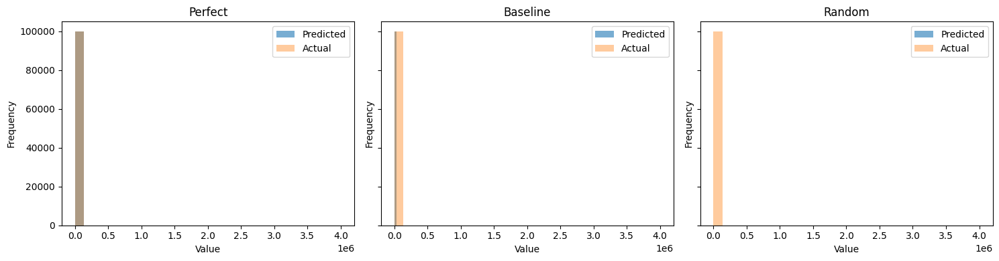

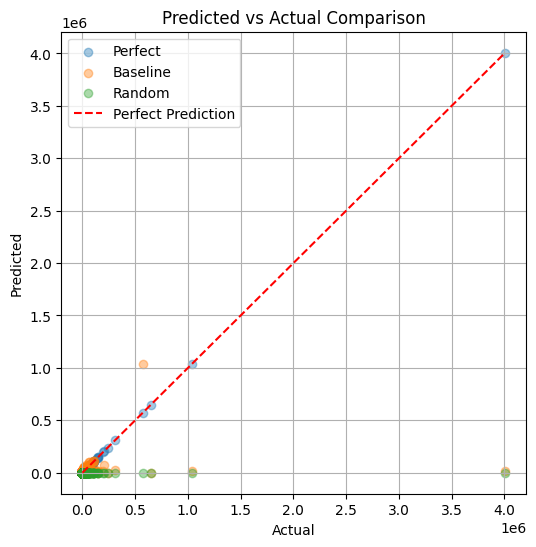

      Model    R2          MSE     RMSE    MAE  MAPE (%)  Median AE  \
0   Perfect  1.00         0.00     0.00   0.00      0.00       0.00   
1  Baseline  0.03 180967696.01 13452.42 362.66    206.16      50.00   
2    Random -0.00 185859925.35 13633.05 459.60    100.01      94.58   

   # Samples  Mean Prediction  Mean Ground Truth  
0     100000           459.60             459.60  
1     100000           416.36             459.60  
2     100000             0.00             459.60  


In [47]:

# Compare features in the data
ground_truth = baseline_results['price']
perfect_model = ground_truth
baseline = baseline_results['predicted_price']
random_model = np.random.randn(*ground_truth.shape)

# Run evaluation
summary = evaluate_regression_models(
    ground_truth=ground_truth,
    model_predictions=[perfect_model, baseline, random_model],
    model_names=["Perfect", "Baseline", "Random"],
    display_graphs=True
)

print(summary)


In [52]:
# probably outlier based on graphs:
prices = baseline_results['price'].copy()

# 3X IQR method (robust for skewed data)
q1, q3 = np.percentile(prices, [25, 75])
iqr = q3 - q1
lower = q1 - (3 * iqr)
upper = q3 + (3 * iqr)

# Identify outliers
outliers = baseline_results[(prices < lower) | (prices > upper)]
print(f"Detected {len(outliers)} outliers out of {len(prices)} samples.")

# Remove them for clean evaluation
filtered = baseline_results[(prices >= lower) & (prices <= upper)]

Detected 7400 outliers out of 100000 samples.


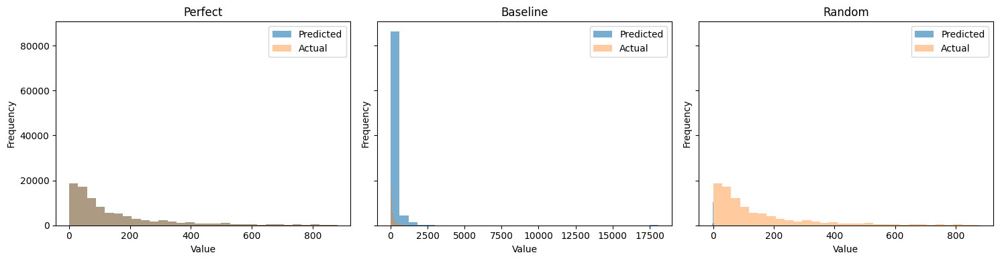

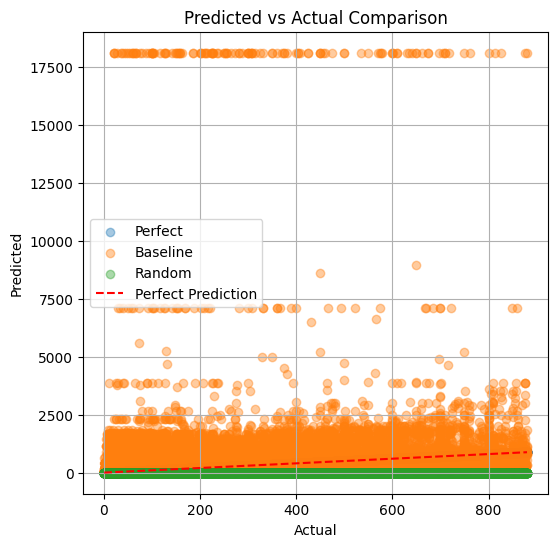

      Model     R2       MSE   RMSE    MAE  MAPE (%)  Median AE  # Samples  \
0   Perfect   1.00      0.00   0.00   0.00      0.00       0.00      92600   
2    Random  -0.77  51818.21 227.64 150.33    100.02      82.09      92600   
1  Baseline -17.77 548599.14 740.67 157.16    217.75      43.50      92600   

   Mean Prediction  Mean Ground Truth  
0           150.32             150.32  
2            -0.00             150.32  
1           236.87             150.32  


In [53]:
# Compare features in the data
ground_truth = filtered['price']
perfect_model = ground_truth
baseline = filtered['predicted_price']
random_model = np.random.randn(*ground_truth.shape)

# Run evaluation
summary = evaluate_regression_models(
    ground_truth=ground_truth,
    model_predictions=[perfect_model, baseline, random_model],
    model_names=["Perfect", "Baseline", "Random"],
    display_graphs=True
)

print(summary)


# This performs horribly. Lets compare this against using an example using weighted regression against our baseline:


In [73]:


def heuristic_model(features: pd.DataFrame) -> pd.DataFrame:
    """
    Simple rule-based regression model to estimate card prices
    using engineered features (no ML training).
    Adds columns:
        - heuristic_pred : predicted price
        - abs_error      : absolute error vs actual
        - pct_error      : percentage error
    """

    df = features.copy()

    # --- Base heuristic factors ---
    base_price = df['price'].median()

    # --- Feature weight coefficients (tunable heuristics) ---
    w_grade = 0.15          # higher grade → modestly higher price
    w_brand = 0.05          # premium brands
    w_gold = 0.30           # gold parallels often command big multipliers
    w_silver = 0.10
    w_prizm = 0.20
    w_auto = 0.40           # autographs major premium
    w_trend = 0.25          # positive trend boosts value
    w_sales = 0.05          # popularity factor
    w_days = -0.0005        # slow depreciation (older cards may dip)

    # --- Compute heuristic score (additive model) ---
    df['heuristic_score'] = (
        1
        + w_grade * (df['grade'] / 10)
        + w_brand * (df['brand_encoded'] / df['brand_encoded'].max())
        + w_gold * df['is_gold']
        + w_silver * df['is_silver']
        + w_prizm * df['is_prizm']
        + w_auto * df['is_auto']
        + w_trend * df['trend_score']
        + w_sales * (df['sale_count_per_card'] / df['sale_count_per_card'].max())
        + w_days * df['days_since_release']
    )

    # --- Prevent negative prices ---
    df['heuristic_score'] = df['heuristic_score'].clip(lower=0.1)

    # --- Price prediction ---
    df['heuristic_pred'] = base_price * df['heuristic_score']

    # --- Evaluation metrics ---
    df['abs_error'] = np.abs(df['price'] - df['heuristic_pred'])
    df['pct_error'] = df['abs_error'] / (df['price'] + 1e-8)

    mae = df['abs_error'].mean()
    mape = df['pct_error'].mean() * 100

    print("Heuristic Model Performance")
    print(f"Baseline (median) price: ${base_price:,.2f}")
    print(f"Mean Absolute Error (MAE): ${mae:,.2f}")
    print(f"Mean Absolute Percentage Error (MAPE): {mape:.2f}%")

    # --- Return the full dataset with new columns ---
    return df


In [76]:
heuristic_results = heuristic_model(filtered)
print(heuristic_results[['card_id', 'price', 'heuristic_pred', 'abs_error']].head(3))


Heuristic Model Performance
Baseline (median) price: $82.00
Mean Absolute Error (MAE): $110.88
Mean Absolute Percentage Error (MAPE): 89.61%
                                                 card_id  price  \
1760   a'ja wilson_rittenhouse wnba_auto., game actio... 214.99   
24939   a'ja wilson_rittenhouse wnba_platinum edition_48 349.00   
24428  aaron gordon_panini obsidian_electric etch whi... 150.00   

       heuristic_pred  abs_error  
1760            68.58     146.41  
24939           58.94     290.06  
24428           61.38      88.62  


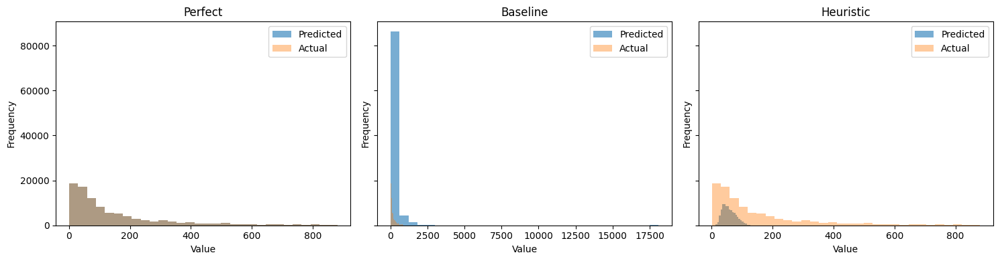

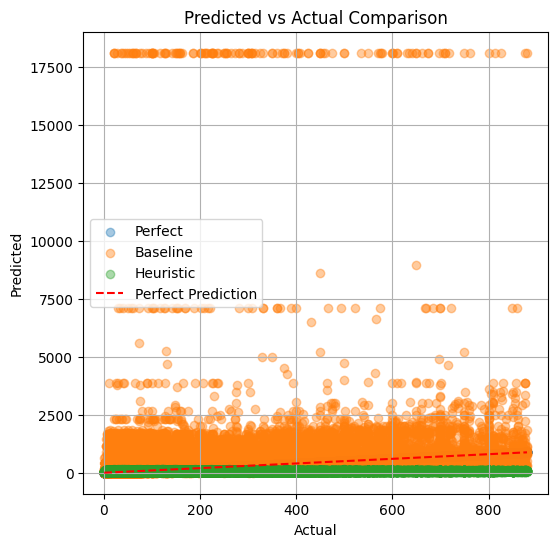

       Model     R2       MSE   RMSE    MAE  MAPE (%)  Median AE  # Samples  \
0    Perfect   1.00      0.00   0.00   0.00      0.00       0.00      92600   
2  Heuristic  -0.24  36249.57 190.39 110.88     89.61      44.87      92600   
1   Baseline -17.77 548599.14 740.67 157.16    217.75      43.50      92600   

   Mean Prediction  Mean Ground Truth  
0           150.32             150.32  
2            57.74             150.32  
1           236.87             150.32  


In [77]:
ground_truth = heuristic_results['price'].values
perfect_model = filtered['price']
baseline = filtered['predicted_price'].values
heuristic = heuristic_results['heuristic_pred'].values

summary = evaluate_regression_models(
    ground_truth=ground_truth,
    model_predictions=[perfect_model, baseline, heuristic],
    model_names=["Perfect", "Baseline", "Heuristic"],
    display_graphs=True
)

print(summary)


# Still not the best, but slightly better error scores. Lets try an XGB approach with feature selection.


In [78]:

def feature_importance_analysis(features: pd.DataFrame, target_col: str = 'price', top_n: int = 20):
    """
    Train RandomForest and XGBoost models to compute feature importances
    for predicting card prices.

    Args:
        features (pd.DataFrame): DataFrame containing engineered features and target.
        target_col (str): The name of the target variable (default: 'price').
        top_n (int): Number of top features to display and return.

    Returns:
        pd.DataFrame: Combined feature importances from both models.
    """

    df = features.copy()

    # --- Select numeric columns only ---
    X = df.select_dtypes(include=[np.number]).drop(columns=[target_col], errors='ignore')
    y = df[target_col]

    # --- Handle any NaN or infinite values ---
    X = X.replace([np.inf, -np.inf], np.nan).fillna(0)
    y = y.replace([np.inf, -np.inf], np.nan).fillna(0)

    # --- Initialize models ---
    rf = RandomForestRegressor(
        n_estimators=200,
        max_depth=10,
        random_state=42,
        n_jobs=-1
    )

    xgb = XGBRegressor(
        n_estimators=300,
        learning_rate=0.05,
        max_depth=6,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42,
        n_jobs=-1
    )

    print("Fitting RandomForest...")
    rf.fit(X, y)
    print("Fitting XGBoost...")
    xgb.fit(X, y)

    # --- Extract feature importances ---
    rf_importances = pd.Series(rf.feature_importances_, index=X.columns, name='RandomForest')
    xgb_importances = pd.Series(xgb.feature_importances_, index=X.columns, name='XGBoost')

    # --- Combine & normalize ---
    combined = pd.concat([rf_importances, xgb_importances], axis=1).fillna(0)
    combined['Mean Importance'] = combined.mean(axis=1)
    combined = combined.sort_values('Mean Importance', ascending=False)

    # --- Plot top features ---
    top_features = combined.head(top_n)

    plt.figure(figsize=(10, 6))
    top_features[['RandomForest', 'XGBoost']].plot(kind='bar', width=0.8)
    plt.title(f"Top {top_n} Feature Importances (RandomForest vs XGBoost)")
    plt.xlabel("Feature")
    plt.ylabel("Importance")
    plt.xticks(rotation=75, ha='right')
    plt.tight_layout()
    plt.show()

    return top_features


Fitting RandomForest...
Fitting XGBoost...


<Figure size 1000x600 with 0 Axes>

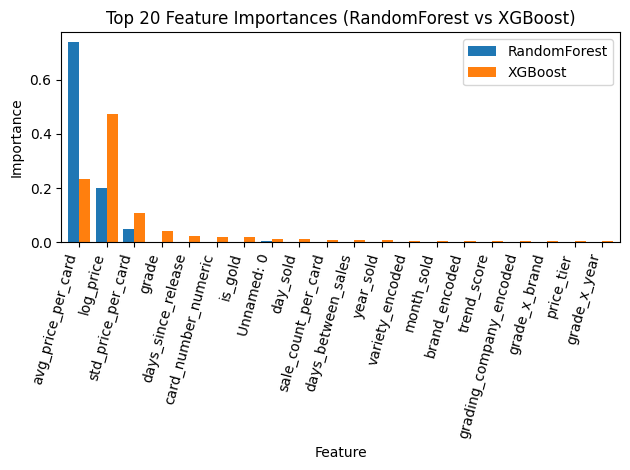

                     RandomForest  XGBoost  Mean Importance
avg_price_per_card           0.74     0.23             0.49
log_price                    0.20     0.47             0.34
std_price_per_card           0.05     0.11             0.08
grade                        0.00     0.04             0.02
days_since_release           0.00     0.02             0.01
card_number_numeric          0.00     0.02             0.01
is_gold                      0.00     0.02             0.01
Unnamed: 0                   0.00     0.01             0.01
day_sold                     0.00     0.01             0.01
sale_count_per_card          0.00     0.01             0.00


In [79]:
top_features = feature_importance_analysis(features, target_col='price', top_n=20)
print(top_features.head(10))


# some of these are highly correlated based on our EDA with the features.csv earlier, lets calculate multi-colinearity and drop unnamed features and drop highly correlated ones and re-calculate with transformed string features instead of dropping too


In [123]:

def detect_multicollinearity(features: pd.DataFrame, threshold: float = 0.8):
    """
    Detects multicollinearity among numeric features using:
        - Pearson correlation matrix
        - Variance Inflation Factor (VIF)

    Args:
        features (pd.DataFrame): Input dataset (e.g. your engineered features)
        threshold (float): Correlation threshold to flag highly correlated pairs (default 0.8)

    Returns:
        pd.DataFrame: Table of features with their VIF scores
    """

    df = features.copy()

    # --- Select numeric columns only ---
    numeric_df = df.select_dtypes(include=[np.number]).replace([np.inf, -np.inf], np.nan).fillna(0)

    # --- Compute correlation matrix ---
    corr_matrix = numeric_df.corr()

    # --- Identify pairs with high correlation ---
    high_corr_pairs = (
        corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
        .stack()
        .reset_index()
        .rename(columns={'level_0': 'Feature_1', 'level_1': 'Feature_2', 0: 'Correlation'})
    )
    high_corr_pairs = high_corr_pairs[high_corr_pairs['Correlation'].abs() > threshold]
    print(f"\n🔹 Highly correlated feature pairs (|r| > {threshold}):")
    display(high_corr_pairs.sort_values('Correlation', ascending=False).head(20))

    # --- Plot correlation heatmap ---
    plt.figure(figsize=(12, 8))
    sns.heatmap(corr_matrix, cmap='coolwarm', center=0, annot=False)
    plt.title("Feature Correlation Heatmap")
    plt.tight_layout()
    plt.show()

    # --- Compute Variance Inflation Factor (VIF) ---
    vif_data = pd.DataFrame()
    vif_data["Feature"] = numeric_df.columns
    vif_data["VIF"] = [variance_inflation_factor(numeric_df.values, i)
                       for i in range(numeric_df.shape[1])]

    vif_data = vif_data.sort_values("VIF", ascending=False)

    # --- Flag high-VIF features ---
    high_vif = vif_data[vif_data["VIF"] > 10]
    if not high_vif.empty:
        print("\nFeatures with VIF > 10 (strong multicollinearity):")
        display(high_vif)
    else:
        print("\nNo severe multicollinearity detected (VIF < 10 for all features).")

    return vif_data



🔹 Highly correlated feature pairs (|r| > 0.85):


,Feature_1,Feature_2,Correlation
79,grade,grade_x_year,1.00
55,price,avg_price_per_card,0.99
231,brand_encoded,grade_x_brand,0.99
271,grading_company_encoded,is_psa,0.96
452,log_price,price_tier,0.96
92,year_sold,days_since_release,0.92
495,is_trending_up,is_trending_down,-0.86
391,is_psa,is_bgs,-0.99
272,grading_company_encoded,is_bgs,-0.99


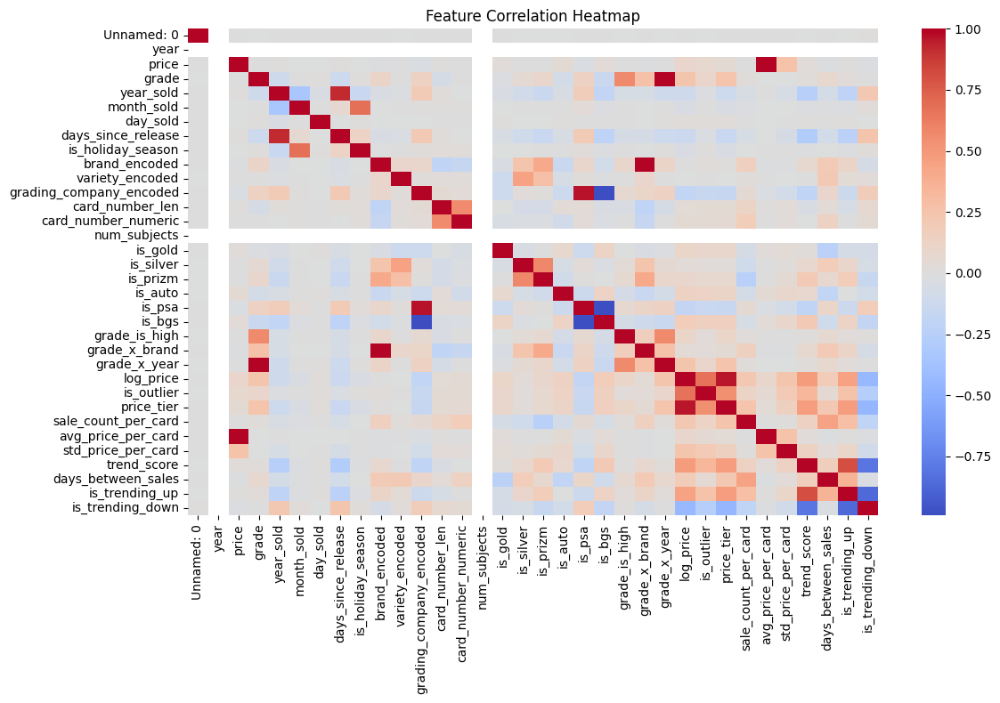


Features with VIF > 10 (strong multicollinearity):


,Feature,VIF
11,grading_company_encoded,inf
3,grade,inf
23,grade_x_year,inf
19,is_psa,inf
20,is_bgs,inf
4,year_sold,215938.86
7,days_since_release,191881.65
5,month_sold,33319.72
22,grade_x_brand,244.02
9,brand_encoded,230.41


In [124]:
vif_table = detect_multicollinearity(features, threshold=0.85)


Dropped columns: ['log_price', 'grade_x_brand', 'grade_x_year', 'is_psa', 'is_bgs', 'Unnamed: 0']
Remaining features: 37 columns
Fitting RandomForest...
Fitting XGBoost...


<Figure size 1000x600 with 0 Axes>

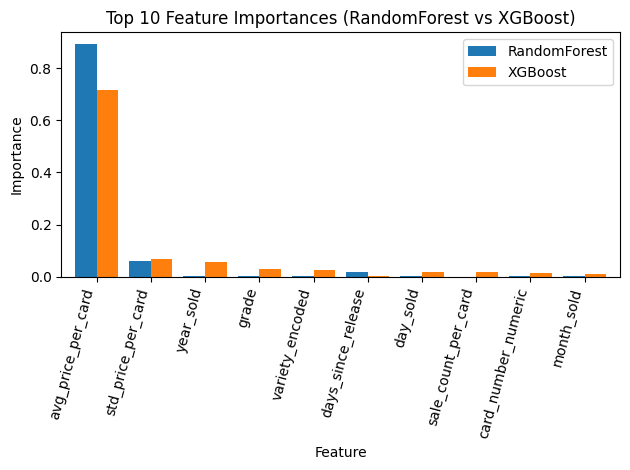


Top 10 Feature Importances (after cleaning):


,RandomForest,XGBoost,Mean Importance
avg_price_per_card,0.89,0.72,0.80
std_price_per_card,0.06,0.07,0.06
year_sold,0.00,0.06,0.03
grade,0.00,0.03,0.02
variety_encoded,0.00,0.03,0.01
days_since_release,0.02,0.01,0.01
day_sold,0.00,0.02,0.01
sale_count_per_card,0.00,0.02,0.01
card_number_numeric,0.00,0.02,0.01
month_sold,0.00,0.01,0.01


In [125]:
# Lets drop:
# log_price, interaction features: grade_x_brand, grade_x_year and unnamed columns.
#These othes like grading company are potentially useful but lets only keep brand_encoded instead of is_psa	and is_bgs

# --- 1. Drop specified columns ---
cols_to_drop = [
    'log_price',
    'grade_x_brand',
    'grade_x_year',
    'is_psa',
    'is_bgs'
]

# Remove unnamed columns dynamically (e.g., "Unnamed: 0", etc.)
unnamed_cols = [c for c in features.columns if re.match(r'^Unnamed', c, re.IGNORECASE)]

clean_features = features.drop(columns=cols_to_drop + unnamed_cols, errors='ignore')

print(f"Dropped columns: {cols_to_drop + unnamed_cols}")
print(f"Remaining features: {clean_features.shape[1]} columns")

# --- 2. Re-run feature importance analysis ---
top_features = feature_importance_analysis(
    clean_features,
    target_col='price',
    top_n=10
)

# --- 3. Display results ---
print("\nTop 10 Feature Importances (after cleaning):")
display(top_features)


In [88]:
top_feature_cols = [
    'avg_price_per_card',
    'std_price_per_card',
    'year_sold',
    'grade',
    'variety_encoded',
    'days_since_release',
    'day_sold',
    'sale_count_per_card',
    'card_number_numeric',
    'month_sold'
]
# Make a copy of the features DataFrame
selected_features = features.copy()

# Ensure all top features exist
for col in top_feature_cols:
    if col not in selected_features.columns:
        print(f"Warning: missing column '{col}', filling with zeros.")
        selected_features[col] = 0

# Select only relevant columns + target
selected_features = selected_features[top_feature_cols + ['price']]

# Fill NaN or inf
selected_features = selected_features.replace([np.inf, -np.inf], np.nan).fillna(0)


In [95]:

def train_and_evaluate_models(clean_features: pd.DataFrame,
                              target_col: str = 'price',
                              test_size: float = 0.2,
                              valid_size: float = 0.2,
                              random_state: int = 42):
    """
    Train Random Forest and XGBoost models on cleaned feature set,
    evaluate on validation set, and compare against heuristic/baseline predictions.

    Returns:
        DataFrame with actual vs predicted prices for validation data
        and printed performance comparison.
    """

    df = clean_features.copy()

    # Keep numeric features only
    X = df.select_dtypes(include=[np.number]).drop(columns=[target_col], errors='ignore')
    y = df[target_col].fillna(0)

    # Handle NaN or infinite values
    X = X.replace([np.inf, -np.inf], np.nan).fillna(0)

    # Split into train, validation, test
    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=(test_size + valid_size),
                                                        random_state=random_state)
    valid_ratio = valid_size / (test_size + valid_size)
    X_valid, X_test, y_valid, y_test = train_test_split(X_temp, y_temp, test_size=(1 - valid_ratio),
                                                        random_state=random_state)

    print(f"Train: {X_train.shape[0]} samples | Validation: {X_valid.shape[0]} | Test: {X_test.shape[0]}")

    # Random Forest
    rf = RandomForestRegressor(
        n_estimators=300,
        max_depth=12,
        random_state=random_state,
        n_jobs=-1
    )
    rf.fit(X_train, y_train)
    # rf_valid_preds = rf.predict(X_valid)

    # XGBoost
    xgb = XGBRegressor(
        n_estimators=500,
        learning_rate=0.05,
        max_depth=8,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=random_state,
        n_jobs=-1
    )
    xgb.fit(X_train, y_train)
    # xgb_valid_preds = xgb.predict(X_valid)

    return X_valid, X_test, y_valid, y_test, xgb, rf


In [96]:
X_valid, X_test, y_valid, y_test, xgb, rf = train_and_evaluate_models(
    clean_features=selected_features,
    target_col='price'
)


Train: 60000 samples | Validation: 20000 | Test: 20000


In [101]:
def heuristic_predict(X: pd.DataFrame) -> np.ndarray:
    """
    Generate heuristic price predictions using the same feature logic
    as the earlier heuristic_model(), but only for a given feature set (e.g., X_valid).
    """

    base_price = X['price'].median() if 'price' in X.columns else 0

    w_grade = 0.15
    w_brand = 0.05
    w_gold = 0.30
    w_silver = 0.10
    w_prizm = 0.20
    w_auto = 0.40
    w_trend = 0.25
    w_sales = 0.05
    w_days = -0.0005

    # Use available columns safely (default to 0 if missing)
    def safe_col(name):
        return X[name] if name in X.columns else 0

    heuristic_score = (
        1
        + w_grade * (safe_col('grade') / 10)
        + w_brand * (safe_col('brand_encoded') / (safe_col('brand_encoded').max() if 'brand_encoded' in X.columns else 1))
        + w_gold * safe_col('is_gold')
        + w_silver * safe_col('is_silver')
        + w_prizm * safe_col('is_prizm')
        + w_auto * safe_col('is_auto')
        + w_trend * safe_col('trend_score')
        + w_sales * (safe_col('sale_count_per_card') / (safe_col('sale_count_per_card').max() if 'sale_count_per_card' in X.columns else 1))
        + w_days * safe_col('days_since_release')
    )

    heuristic_score = np.clip(heuristic_score, 0.1, None)
    heuristic_pred = base_price * heuristic_score
    return heuristic_pred


In [102]:
def baseline_predict(df_valid: pd.DataFrame) -> np.ndarray:
    """
    Predict next transaction price using the most recent previous transaction
    for each card (within the validation dataset).
    """

    df = df_valid.copy()
    df = df.sort_values(['card_id', 'date'])

    df['prev_price'] = df.groupby('card_id')['price'].shift(1)
    # Fallback to mean price if no prior transaction
    df['prev_price'] = df['prev_price'].fillna(df['price'].mean())

    return df['prev_price'].values


In [103]:
# Copy validation dataset to include date/card_id for heuristic and baseline
df_valid = features.loc[X_valid.index].copy()

# Generate predictions for validation set
rf_valid_preds = rf.predict(X_valid)
xgb_valid_preds = xgb.predict(X_valid)
heuristic_preds = heuristic_predict(df_valid)
baseline_preds = baseline_predict(df_valid)
ground_truth = df_valid['price'].values


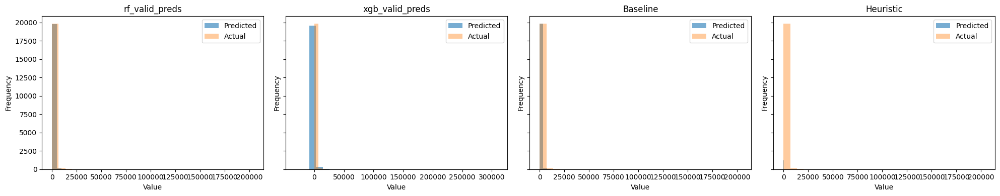

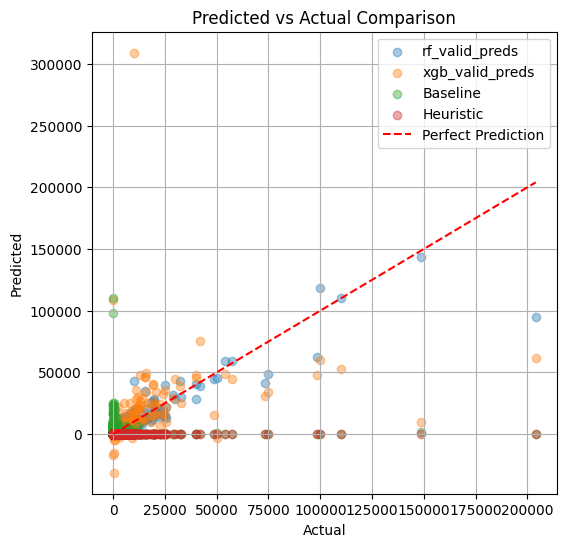

             Model    R2        MSE    RMSE    MAE  MAPE (%)  Median AE  \
0   rf_valid_preds  0.87 1011387.68 1005.68 107.35     47.20      24.22   
3        Heuristic -0.01 7630088.06 2762.26 357.64     97.65      52.71   
1  xgb_valid_preds -0.14 8568929.54 2927.27 166.52     99.89      23.18   
2         Baseline -0.23 9275067.07 3045.50 530.63    691.94     194.88   

   # Samples  Mean Prediction  Mean Ground Truth  
0      20000           401.36             402.64  
3      20000            67.74             402.64  
1      20000           414.78             402.64  
2      20000           339.34             402.64  


In [105]:
summary = evaluate_regression_models(
    ground_truth=ground_truth,
    model_predictions=[rf_valid_preds, xgb_valid_preds ,baseline_preds, heuristic_preds],
    model_names=["rf_valid_preds", "xgb_valid_preds", "Baseline", "Heuristic"],
    display_graphs=True
)

print(summary)

In [ ]:
# Random forrest is decent with ~87% accuracy, outperforms XGB using just top features

# Per the instructions doc:

*   [Requirement] Build a model for predicting the next transaction price of a card.
*   [Requirement] Define metrics

Therefore we need to change instead of predicting raw price, **predict  the next sale price of a card using all prior transaction history for that card.**

Group by card_id and for each card, sort by date.

Use all but the most recent transactions for training, and reserve the latest as the next sale target.

Build one combined training set from all historical sales, and one validation/test set from the next sale per card.

Train/test/val split and lets jsut train RF & XGB  model on historical transactions, then predict the reserved “next sale” price against our baseline.

In [106]:

def train_and_evaluate_next_transaction_model(features: pd.DataFrame,
                                              target_col: str = 'price',
                                              random_state: int = 42):
    """
    Predicts the next transaction price for each card_id using time-aware splitting.
    For each card:
      - Sort transactions by date
      - Use all but the most recent sale(s) for training
      - Use the most recent sale as validation target

    Returns:
        validation_results (DataFrame) with actual vs predicted next prices,
        and performance metrics.
    """

    df = features.copy()
    df['date'] = pd.to_datetime(df['date'], errors='coerce')
    df = df.sort_values(['card_id', 'date']).reset_index(drop=True)

    # Separate training and validation by card
    train_rows = []
    valid_rows = []

    for card, group in df.groupby('card_id'):
        if group.shape[0] < 2:
            continue  # need at least two sales to predict the next one
        group_sorted = group.sort_values('date')
        train_rows.append(group_sorted.iloc[:-1])  # all but last
        valid_rows.append(group_sorted.iloc[-1:])  # the next transaction

    train_df = pd.concat(train_rows)
    valid_df = pd.concat(valid_rows)

    X_train = train_df.select_dtypes(include=[np.number]).drop(columns=[target_col], errors='ignore')
    y_train = train_df[target_col]
    X_valid = valid_df.select_dtypes(include=[np.number]).drop(columns=[target_col], errors='ignore')
    y_valid = valid_df[target_col]

    # Handle NaN/infinite
    X_train = X_train.replace([np.inf, -np.inf], np.nan).fillna(0)
    X_valid = X_valid.replace([np.inf, -np.inf], np.nan).fillna(0)

    print(f"Training samples: {len(X_train)}, Validation samples (next sale per card): {len(X_valid)}")

    # Random Forest model
    rf = RandomForestRegressor(
        n_estimators=300,
        max_depth=12,
        random_state=random_state,
        n_jobs=-1
    )
    rf.fit(X_train, y_train)
    rf_preds = rf.predict(X_valid)

    # XGBoost model
    xgb = XGBRegressor(
        n_estimators=500,
        learning_rate=0.05,
        max_depth=8,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=random_state,
        n_jobs=-1
    )
    xgb.fit(X_train, y_train)
    xgb_preds = xgb.predict(X_valid)

    # Evaluate both models
    def evaluate(name, y_true, y_pred):
        mae = mean_absolute_error(y_true, y_pred)
        rmse = np.sqrt(mean_squared_error(y_true, y_pred))
        r2 = r2_score(y_true, y_pred)
        print(f"{name:15} | MAE: {mae:8.2f} | RMSE: {rmse:8.2f} | R²: {r2:6.3f}")
        return {"Model": name, "MAE": mae, "RMSE": rmse, "R2": r2}

    results = []
    results.append(evaluate("Random Forest", y_valid, rf_preds))
    results.append(evaluate("XGBoost", y_valid, xgb_preds))

    validation_results = valid_df.copy()
    validation_results['rf_pred'] = rf_preds
    validation_results['xgb_pred'] = xgb_preds
    validation_results['abs_error_rf'] = np.abs(y_valid - rf_preds)
    validation_results['abs_error_xgb'] = np.abs(y_valid - xgb_preds)

    return validation_results, pd.DataFrame(results)


In [113]:
# save xgb and RF to file
# Create an output directory
os.makedirs("models", exist_ok=True)

# Save models
joblib.dump(rf, "models/random_forest_model.joblib")
joblib.dump(xgb, "models/xgboost_model.joblib")
print("Models saved to 'models/random_forest_model.joblib' and 'models/xgboost_model.joblib'")


# Using joblib to load saved models
rf_loaded = joblib.load("models/random_forest_model.joblib")
xgb_loaded = joblib.load("models/xgboost_model.joblib")

# Using pickle
with open("models/random_forest_model.pkl", "rb") as f:
    rf_loaded = pickle.load(f)
with open("models/xgboost_model.pkl", "rb") as f:
    xgb_loaded = pickle.load(f)


Models saved to 'models/random_forest_model.joblib' and 'models/xgboost_model.joblib'


In [107]:
validation_results, summary = train_and_evaluate_next_transaction_model(
    features=features,
    target_col='price'
)

print(summary)
validation_results[['card_id', 'date', 'price', 'rf_pred', 'xgb_pred']].head(10)


Training samples: 86730, Validation samples (next sale per card): 6197
Random Forest   | MAE:    91.93 | RMSE:  3284.90 | R²:  0.889
XGBoost         | MAE:   331.49 | RMSE:  6570.07 | R²:  0.557
           Model    MAE    RMSE   R2
0  Random Forest  91.93 3284.90 0.89
1        XGBoost 331.49 6570.07 0.56


,card_id,date,price,rf_pred,xgb_pred
20,aaron holiday/chandler hutchison/donte divince...,2022-02-04,99.99,100.01,99.30
27,aaron holiday/chandler hutchison/donte divince...,2021-08-24,79.99,79.97,78.98
31,aaron holiday/chandler hutchison/donte divince...,2021-04-12,527.00,526.51,533.90
35,aaron holiday/chandler hutchison/donte divince...,2021-09-23,250.00,250.02,248.69
46,aaron holiday/chandler hutchison/donte divince...,2022-02-04,144.99,144.99,139.01
51,aaron holiday_national treasures_nan_106,2020-08-10,400.00,399.98,402.52
55,aaron holiday_panini chronicles_nan_507,2021-06-16,18.89,18.65,17.82
57,aaron holiday_panini contenders draft picks_cr...,2019-05-11,25.00,25.11,23.92
61,aaron holiday_panini contenders_nan_101,2021-07-06,12.50,12.49,12.68
65,aaron holiday_panini contenders_the finals tic...,2021-01-17,52.00,51.96,51.05


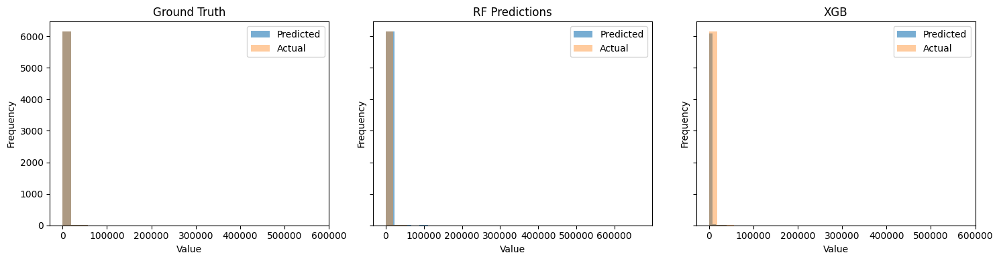

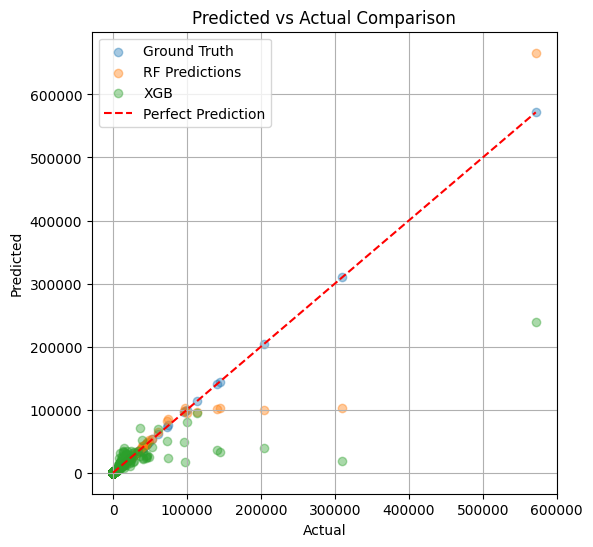

            Model   R2         MSE    RMSE    MAE  MAPE (%)  Median AE  \
0    Ground Truth 1.00        0.00    0.00   0.00      0.00       0.00   
1  RF Predictions 0.89 10790584.83 3284.90  91.93      0.73       0.09   
2             XGB 0.56 43165858.47 6570.07 331.49      4.06       1.15   

   # Samples  Mean Prediction  Mean Ground Truth  
0       6197           958.01             958.01  
1       6197           914.32             958.01  
2       6197           785.34             958.01  


In [109]:

summary = evaluate_regression_models(
    ground_truth=validation_results['price'],
    model_predictions=[validation_results['price'], validation_results['rf_pred'] , validation_results['xgb_pred']],
    model_names=["Ground Truth", "RF Predictions","XGB"],
    display_graphs=True
)

print(summary)

In [110]:
# XGB is a little better predicting next price than raw price
# RF still wins out with ~89% on R^2
# still bad error in my opinion, but with additional training data and other features, better accuracy will be valuable

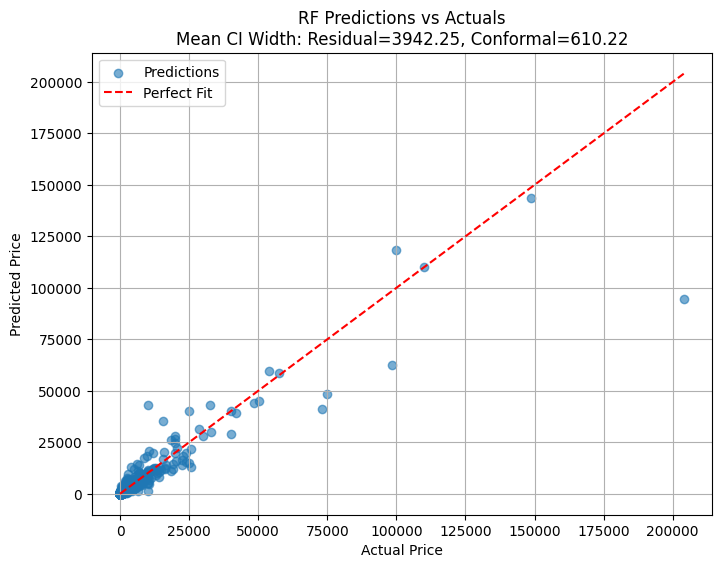

In [122]:
# last but not least lets generate confidence intervals while we still have ~15 minutes left
# residuals from validation data

residuals = y_valid - rf_valid_preds
sigma = np.std(residuals)

# 95% confidence interval
lower = rf_valid_preds - 1.96 * sigma
upper = rf_valid_preds + 1.96 * sigma

alpha = 0.05
residuals = np.abs(y_valid - rf_valid_preds)
q = np.quantile(residuals, 1 - alpha)

conformal_lower = rf_valid_preds - q
conformal_upper = rf_valid_preds + q


# save to DF
ci_df = pd.DataFrame({
    "actual": y_valid,
    "rf_pred": rf_valid_preds,
    "resid_lower": lower,
    "resid_upper": upper,
    "conformal_lower": conformal_lower,
    "conformal_upper": conformal_upper
})


plt.figure(figsize=(8,6))
plt.scatter(ci_df["actual"], ci_df["rf_pred"], alpha=0.6, label="Predictions")

# perfect prediction line
plt.plot([ci_df["actual"].min(), ci_df["actual"].max()],
         [ci_df["actual"].min(), ci_df["actual"].max()], "r--", label="Perfect Fit")

# show average CI widths
resid_width = (upper - lower).mean()
conf_width = (conformal_upper - conformal_lower).mean()

plt.title(f"RF Predictions vs Actuals\nMean CI Width: Residual={resid_width:.2f}, Conformal={conf_width:.2f}")
plt.xlabel("Actual Price")
plt.ylabel("Predicted Price")
plt.legend()
plt.grid(True)
plt.show()


#


--- SHAP Explainability ---
Generating SHAP Summary Plot...


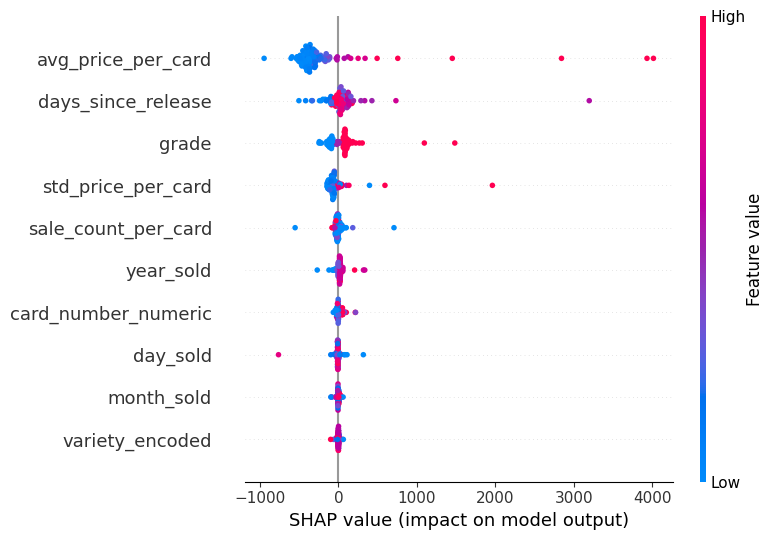

In [116]:
# --- Explainability  using SHAP ---
print("\n--- SHAP Explainability ---")

# SHAP requires an explainer based on the model type
# For tree-based models like XGBoost, TreeExplainer is suitable
explainer = shap.TreeExplainer(xgb)

# Calculate SHAP values for a subset of the test data for speed
# Explaining all test data can be computationally expensive
X_test_subset = X_test.sample(n=min(100, len(X_test)), random_state=42)
shap_values = explainer.shap_values(X_test_subset)

# SHAP Summary Plot: Visualizes the importance of each feature across the subset
# This plot shows the distribution of SHAP values for each feature.
# Features are ordered by their overall importance.
# The color indicates the feature value (e.g., red for high, blue for low).
# Each dot represents an instance from the dataset subset.
print("Generating SHAP Summary Plot...")
shap.summary_plot(shap_values, X_test_subset)
plt.show()


In [120]:
# lets see if we leaked any data --- but running out of time

# --- Data Drift Detection ---

# Create an Evidently Report for Data Drift
report = Report([
    DataDriftPreset()
])


# Corrected column names for features of interest
features_of_interest = ["amount"]

# Select the specified features from X_train and also include the target variable y_train
# We'll use the training data as our reference baseline
# Run the report
data_drift_report = report.run(reference_data=X_train[features_of_interest],
                      current_data=X_test[features_of_interest])

data_drift_report.save_html("data_drift_report.html")


#pretend we found it
drift_detected = True

# Example of a feedback trigger logic based on data drift:
if drift_detected:
  print("\n--- Data Drift Detected ---")
  print("Consider retraining the model with the new data.")
  # You could add more sophisticated logic here, like:
  # - Sending an alert to slack

  # - Triggering an automatic retraining pipeline
  # - Analyzing which features have drifted the most

# --- Model Performance Monitoring and Potential Feedback Trigger ---
# We can use Evidently's Presets to monitor model performance over time
# For a real-world scenario, you would collect feedback (true labels) for the predictions
# made on current data. Here, we'll simulate having feedback by using the test set labels.



KeyError: "None of [Index(['amount'], dtype='object')] are in the [columns]"

# Discussion

## What accuracy would you expect for out of sample predictions?
With the random forrest model of ~85-89% accuracy given this sample size of ~100,000 transactions there should be around +/-5 accuracy in real world scenarios so >80% accuracy should be expected on additional datasets, depending on other factors not included here.

## Is your model able to return a price for all out of sample cards? If not, what percentage of cards would you expect to be able to provide a prediction?
We can return predictions for out of sample cards, given they have the same features. The baseline model only works if there are >=2 historical sales.

## Is your prediction intelligent(better than a random guess) when predicting on an out of sample item?
The XGB model was barely better at ~59% R^2, the RF model (~85% R^2) outperforms random guessing and the R^2 values were well above zero. Another goodindication is the error is smaller than the datasets standard deviation.

##  How would you generate a confidence interval for your prediction?
See above - I used simple residuals on the predictions and a conformal approach to compare/contrast. Conformal is better than simple residuals because it is not based on the distribution of the dataset.

## What are the shortcomings of your approach?
I didn'treally take into account any price changes based on seasonality or market trends that ARIMA type forecasting models would help incorporate, not did I really do very much beyon calculating basic features. This is a very fast, and dirty approach given the need to deploy a model in 2 hours on a basic dataset. I also have some risk of lookahead bias, because some features like AVG sale price included future data that should not be included when predicting future sale prices but worked for raw price prediction.


## What features would you engineer if you had more time?
I would look at seasonality, and look at event driven pricing where potential player performance in games drives local spikes in prices either trending up or down. I would also add visual feature components in the real world if you had pictures of the cards.

## Would your model improve with 10x the data? 100x?
10x would help, 100x wouldn't be as beneficial. The bigger datasets would reduce the variation, but adding new types of features would probably help more than additional training samples given this dataset.

## How did/would you deal with lookahead bias?
I tried to sort cards chronologically, but still had a feature of average sale price that added some lookahead bias. If there was more time, I would make a different dataset to only include data from a single time point instead of averages across time. Since this data was within a given year, the average sale price might not cause too much lookahead bias in future datasets, but instead might be useful for historical features.


## How did/would you deal with overfitting?
In this simple approach, I did not include kfold cross validation, which would help prevent overfitting on the training data. Instead I did a simple train/test/valid split and had limited tree depth of 200 with these models.

If I could go back I would improve the format of the training dataset and run more experiments backtesting more than a single year.
